Appended project root to sys.path: c:\Users\Rayyan Khan\Desktop\ORBML2
Config loaded successfully.
Initializing ORB ML Simulator...
Configuration loaded from: ../config/config.yaml
Simulator using absolute model path: c:\Users\Rayyan Khan\Desktop\ORBML2\models/
Simulator using absolute processed data path: c:\Users\Rayyan Khan\Desktop\ORBML2\data/processed/
Loading models and scalers...
 Attempting to load regime model from: c:\Users\Rayyan Khan\Desktop\ORBML2\models/regime_model.joblib
 Attempting to load regime scaler from: c:\Users\Rayyan Khan\Desktop\ORBML2\models/regime_scaler.joblib
 Attempting to load meta model from: c:\Users\Rayyan Khan\Desktop\ORBML2\models/meta_labeling_model.joblib
 Attempting to load meta scaler from: c:\Users\Rayyan Khan\Desktop\ORBML2\models/meta_labeling_scaler.joblib
Models and scalers loaded successfully.
Loading feature data...
Attempting to load feature data from: c:\Users\Rayyan Khan\Desktop\ORBML2\data/processed/features_and_labels.parquet
Feature

Simulating:   0%|          | 1/1372597 [00:00<112:13:49,  3.40it/s]c:\Users\Rayyan Khan\Desktop\ORBML2\venv\Lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
c:\Users\Rayyan Khan\Desktop\ORBML2\venv\Lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
c:\Users\Rayyan Khan\Desktop\ORBML2\venv\Lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
c:\Users\Rayyan Khan\Desktop\ORBML2\venv\Lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
Simulating:   0%|          | 526/1372597 [00:00<14:03, 1626.22it/s]c:\Users\Rayyan Khan\Desktop\O


Simulation finished.
Total Trades Simulated: 5

Simulation generated 5 trades.
                             Entry time Market pos.  Qty  Entry price  \
Exit time                                                               
2021-02-17 09:34:00 2021-02-17 09:06:00        Long    2     13771.50   
2021-07-02 08:52:00 2021-07-02 08:45:00       Short    2     14558.75   
2023-09-06 09:15:00 2023-09-06 09:10:00        Long    2     15484.00   
2023-10-31 13:36:00 2023-10-31 09:04:00        Long    2     14407.50   
2024-01-24 14:30:00 2024-01-24 09:13:00        Long    2     17648.00   

                     Exit price  Profit    Exit reason  
Exit time                                               
2021-02-17 09:34:00    13755.25   -32.5      Stop loss  
2021-07-02 08:52:00    14564.25   -11.0      Stop loss  
2023-09-06 09:15:00    15467.75   -32.5      Stop loss  
2023-10-31 13:36:00    14373.00   -69.0      Stop loss  
2024-01-24 14:30:00    17694.25    92.5  Profit target  

Calculat

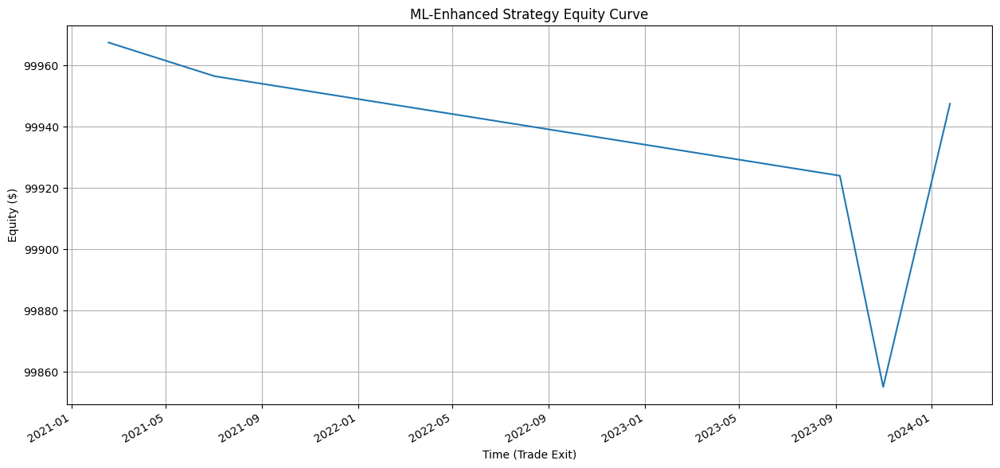

Simulated trade log saved to: ..\results/backtest_log_ml.csv
Performance metrics saved to: ..\results/performance_ml_enhanced.txt

Error comparing with original strategy: name 'load_trade_data' is not defined


In [1]:
# %% [markdown]
# # 6. Backtesting Simulation
#
# **Purpose:** Run the ML-enhanced ORB strategy simulation using the feature data, trained models, and defined logic. Analyze the performance results.

# %%
import pandas as pd
import numpy as np
import yaml
import os
import matplotlib.pyplot as plt
import seaborn as sns

# Import custom functions and class
import sys
# Add project root directory to path for importing modules from src
# Go up one level ('..') from the notebook directory
project_root = os.path.abspath(os.path.join('..'))
if project_root not in sys.path:
     sys.path.append(project_root)
     print(f"Appended project root to sys.path: {project_root}")

# Now import using src.module_name
from src.simulation import OrbMlSimulator # The main simulation class
from src.utils import calculate_performance_metrics # For comparison if needed

# Set display options
pd.set_option('display.max_rows', 100)

# %% [markdown]
# ## Load Configuration

# %%
CONFIG_PATH = '../config/config.yaml'
try:
    with open(CONFIG_PATH, 'r') as f:
        config = yaml.safe_load(f)
    print("Config loaded successfully.")
except FileNotFoundError:
    print(f"ERROR: Config file not found at {CONFIG_PATH}")
    config = None
except Exception as e:
    print(f"ERROR loading config: {e}")
    config = None

if config is None:
    raise ValueError("Failed to load configuration.")

# Define paths
RESULTS_DIR = os.path.join('..', config['data_paths']['results_dir'])
os.makedirs(RESULTS_DIR, exist_ok=True)
PLOT_DIR = os.path.join(RESULTS_DIR, 'plots')
os.makedirs(PLOT_DIR, exist_ok=True)

# Simulation period (use validation and test periods for evaluation)
SIM_START_DATE = config['data_split']['train_end'] # Start simulation after training period ends
SIM_END_DATE = None # Run through the end of the available data

# %% [markdown]
# ## Initialize and Run Simulator
# Create an instance of the `OrbMlSimulator`. This will load config, models, and data internally. Then, call `run_simulation`.

# %%
simulator = None
simulated_trades_df = None
try:
    # Initialization loads data and models, might raise errors if files missing
    simulator = OrbMlSimulator(config_path=CONFIG_PATH)

    print(f"\nRunning simulation from {SIM_START_DATE} to {SIM_END_DATE or 'end of data'}...")
    simulated_trades_df = simulator.run_simulation(start_date=SIM_START_DATE, end_date=SIM_END_DATE)

    if simulated_trades_df is None or simulated_trades_df.empty:
        print("Simulation did not generate any trades.")
    else:
        print(f"\nSimulation generated {len(simulated_trades_df)} trades.")
        print(simulated_trades_df.head())

except Exception as e:
    print(f"\nERROR during simulator initialization or run: {e}")
    # Depending on the error, simulator or simulated_trades_df might be None


# %% [markdown]
# ## Calculate and Display Performance Metrics
# Use the simulator's built-in method to calculate performance.

# %%
performance_metrics = None
if simulator is not None and simulated_trades_df is not None and not simulated_trades_df.empty:
    print("\nCalculating performance metrics...")
    # Pass initial capital if desired, otherwise uses default
    performance_metrics = simulator.calculate_performance(results_df=simulated_trades_df, initial_capital=100000)
else:
    print("Skipping performance calculation.")


# %% [markdown]
# ## Plot Equity Curve

# %%
if simulated_trades_df is not None and not simulated_trades_df.empty and 'Profit' in simulated_trades_df.columns:
    print("\nPlotting Equity Curve...")
    initial_capital = 100000 # Match capital used in metrics calculation
    simulated_trades_df['Cumulative Profit'] = simulated_trades_df['Profit'].cumsum()
    simulated_trades_df['Equity Curve'] = initial_capital + simulated_trades_df['Cumulative Profit']

    plt.figure(figsize=(15, 7))
    simulated_trades_df['Equity Curve'].plot(title='ML-Enhanced Strategy Equity Curve')
    plt.ylabel('Equity ($)')
    plt.xlabel('Time (Trade Exit)')
    plt.grid(True)
    plot_path = os.path.join(PLOT_DIR, 'equity_curve_ml.png')
    plt.savefig(plot_path)
    print(f"Equity curve plot saved to {plot_path}")
    plt.show()

else:
    print("Skipping equity curve plot.")

# %% [markdown]
# ## Save Results
# Save the simulated trade log and performance metrics.

# %%
if simulated_trades_df is not None and not simulated_trades_df.empty:
    try:
        # Save Trade Log
        log_filename = 'backtest_log_ml.csv'
        log_path = os.path.join(RESULTS_DIR, log_filename)
        # Select relevant columns if needed before saving
        simulated_trades_df.to_csv(log_path)
        print(f"Simulated trade log saved to: {log_path}")

        # Save Performance Metrics
        if performance_metrics:
            perf_filename = 'performance_ml_enhanced.txt'
            perf_path = os.path.join(RESULTS_DIR, perf_filename)
            with open(perf_path, 'w') as f:
                for key, value in performance_metrics.items():
                     f.write(f"{key}: {value}\n")
            print(f"Performance metrics saved to: {perf_path}")

    except Exception as e:
        print(f"ERROR saving results: {e}")
else:
    print("Skipping saving results as no trades were generated.")


# %% [markdown]
# ## Compare with Original Strategy (Optional)
# Load original trade log again and calculate metrics using the same utility function for direct comparison.

# %%
# Load original trade log
try:
    RAW_DATA_DIR_COMP = os.path.join('..', config['data_paths']['raw_data_dir'])
    TRADE_LOG_FILE_COMP = config['data_paths']['trade_log_file']
    trade_log_path_comp = os.path.join(RAW_DATA_DIR_COMP, TRADE_LOG_FILE_COMP)
    original_trade_df = load_trade_data(trade_log_path_comp) # Reload or use df from Notebook 01 if still in memory

    if original_trade_df is not None:
        # Filter original trades to match simulation period for fair comparison
        original_trade_df_filtered = original_trade_df[
            (original_trade_df['Exit time'] >= pd.to_datetime(SIM_START_DATE))
        ]
        if SIM_END_DATE:
             original_trade_df_filtered = original_trade_df_filtered[
                  original_trade_df_filtered['Exit time'] <= pd.to_datetime(SIM_END_DATE)
             ]


        if not original_trade_df_filtered.empty:
             print("\n--- Original Strategy Performance (Simulation Period) ---")
             # Assuming you have src.utils with calculate_performance_metrics
             from utils import calculate_performance_metrics
             original_metrics = calculate_performance_metrics(original_trade_df_filtered, initial_capital=100000)
             for key, value in original_metrics.items():
                 print(f"{key}: {value:.2f}" if isinstance(value, (int, float)) else f"{key}: {value}")

             # Save original metrics to file
             perf_orig_filename = 'performance_original_sim_period.txt'
             perf_orig_path = os.path.join(RESULTS_DIR, perf_orig_filename)
             with open(perf_orig_path, 'w') as f:
                 for key, value in original_metrics.items():
                      f.write(f"{key}: {value}\n")
             print(f"Original strategy performance (sim period) saved to: {perf_orig_path}")

        else:
             print("\nNo original trades found in the simulation period for comparison.")

except Exception as e:
     print(f"\nError comparing with original strategy: {e}")


# %% [markdown]
# ---
# End of Notebook 06
# ---